### **Notebook 04: Segmentation and Validation**

This notebook executes the core segmentation stage of the analysis pipeline. It uses the validated task list from Notebook 03 to generate instance-level segmentations for `person`, `face`, and `hand` using the Lang-SAM model. Following automated segmentation, a protocol-driven, human-in-the-loop QC process is applied to curate two high-confidence data cohorts. From these curated cohorts, deterministic and mutually exclusive class union masks are constructed, providing the foundational semantic regions for the final fixation assignment and statistical analysis in Notebook 05.

This notebook transitions the analysis from image-level presence flags to high-fidelity, pixel-level semantic masks. The stability analysis in Notebook 03 indicated that while coarse human presence detection is robust, finer-grained flags for faces and hands are sensitive to minor perturbations. Therefore, an explicit, manual QC step is needed to filter noisy or inaccurate automated segmentations and ensure that the final analysis is based on anatomically plausible regions. The pipeline is long-running so is designed to be deterministic and idempotent, allowing for resumption from interruptions and guaranteeing reproducible outputs. By separating segmentation, QC, and class union construction into distinct, auditable steps, this workflow produces a reliable dataset for the final analysis of attentional allocation.

---

### **Section 0: Setup and Configuration**

In [15]:
# --- Section 0: Setup and Configuration ---

# --- Notebook-specific constants ---
NOTEBOOK_NUM = 4

# --- Standard libraries and third-party imports ---
import os
import sys
import random
import json
import csv
import base64
import io
from pathlib import Path
from typing import List, Tuple, Dict, Any, Optional, Iterable

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.io
from PIL import Image, ImageDraw
from tqdm.auto import tqdm
from IPython.display import display

# AI / DL
import torch
from lang_sam import LangSAM

# --- Project-specific imports and configuration ---
# This assumes the notebook is in notebooks/ and config.py is in src/
sys.path.insert(0, str(Path("../src").resolve()))
import config

# --- Helper Functions ---

def get_output_path(section_num: int, filename: str) -> Path:
    """Generates a standardized output path for notebook artifacts."""
    output_dir = config.RESULTS_DIR / f"notebook{NOTEBOOK_NUM:02d}" / f"section{section_num:02d}"
    output_dir.mkdir(parents=True, exist_ok=True)
    return output_dir / filename

def enforce_category_order(df: pd.DataFrame, col: str = "category") -> pd.DataFrame:
    """Casts a column to the canonical categorical ordering and returns a sorted copy."""
    if col not in df.columns:
        return df
    out = df.copy()
    dtype = pd.CategoricalDtype(config.CAT_ORDER, ordered=True)
    out[col] = out[col].astype(dtype) 
    return out.sort_values(col)

def save_dataframe_as_markdown(df: pd.DataFrame, filepath: Path, title: str = ""):
    """Saves a DataFrame to Markdown with consistent numeric formatting."""
    df_to_write = df.copy()

    def _fmt_float(x: float) -> str:
        if pd.isna(x):
            return ""
        if 0 < abs(x) < 0.001:
            return f"{x:.2e}"
        return f"{x:.3f}"

    df_fmt = df_to_write 
    for col in df_fmt.select_dtypes(include=[float]).columns:
        df_fmt[col] = df_fmt[col].map(_fmt_float)
    
    with open(filepath, "w", encoding="utf-8") as f:
        if title:
            f.write(f"## {title}\n\n")
        f.write(df_fmt.to_markdown(index=False))
    print(f"[saved] {filepath}")

# --- Environment Setup ---

# Set pandas display options
pd.set_option("display.max_columns", None)
pd.set_option("display.width", 1000)

# Configure seaborn plotting style using the canonical order and map
_palette = [config.CATEGORY_COLORS[c] for c in config.CATEGORIES]
sns.set_theme(style="whitegrid", palette=_palette)

# Set random seeds for reproducibility
random.seed(config.RANDOM_SEED)
np.random.seed(config.RANDOM_SEED)

# --- Configuration Snapshot ---
print("[config] Project configuration")
for key, value in sorted({k: v for k, v in config.__dict__.items() if k.isupper() and not k.startswith("_")}.items()):
    if isinstance(value, Path):
        value = str(value)
    print(f"{key:<28}: {value}")

print("\n[ok] Setup complete.")

[config] Project configuration
ANTHROPOMORPHIC_CATEGORIES  : ['Action', 'Affective', 'Social']
BOXPLOT_WIDTH               : 0.45
CAT2000_DIR                 : /home/nico/Projects/final_project/data/CAT2000/trainSet
CATEGORIES                  : ['Action', 'Affective', 'Social', 'Indoor', 'OutdoorManMade', 'OutdoorNatural']
CATEGORY_COLORS             : {'Action': '#7ad151', 'Affective': '#414487', 'Social': '#fde725', 'Indoor': '#22a884', 'OutdoorManMade': '#2a7886', 'OutdoorNatural': '#440154'}
CATEGORY_ORDER              : ['Action', 'Affective', 'Social', 'Indoor', 'OutdoorManMade', 'OutdoorNatural']
CATEGORY_PALETTE            : ['#7ad151', '#414487', '#fde725', '#22a884', '#2a7886', '#440154']
CAT_ORDER                   : ['Action', 'Affective', 'Social', 'Indoor', 'OutdoorManMade', 'OutdoorNatural']
CENTER_BIAS_SIGMA_X_FRAC    : 0.3
CENTER_BIAS_SIGMA_Y_FRAC    : 0.3
DATA_DIR                    : /home/nico/Projects/final_project/data
DBSCAN_EPS                  : 60
DBSCAN_MIN_

---

### **Section 1: Task List Validation**

**Objective**

Normalize the Notebook 03 task list into a wide per-image table with 0/1 prompt flags and a short category summary.

**Rationale**

Early schema checks and explicit flags prevent silent failures, keep the run deterministic, and make the pipeline auditable.

**Inputs**

* `results/notebook03/section03/tbl_segmentation_task_list.csv`
* `src/config.py` and referenced images

**Outputs**

* `results/notebook04/section01/tbl_segmentation_task_list_validated.csv`
* `results/notebook04/section01/tbl_segmentation_task_list_summary.csv/.md`
* `results/notebook04/section01/tbl_segmentation_task_list_missing_files.csv` if needed

In [2]:
# --- Section 1: Task List Validation ---

def validate_task_list():
    """
    Loads and validates the task list from Notebook 03, normalizing it to a
    wide format with explicit prompt flags.
    """
    # --- 1. Load Inputs ---
    task_list_path = config.RESULTS_DIR / "notebook03/section03/tbl_segmentation_task_list.csv"
    print(f"[info] Reading task list: {task_list_path}")
    if not task_list_path.exists():
        raise FileNotFoundError(f"[error] Missing input file: {task_list_path}")
    df = pd.read_csv(task_list_path)

    # --- 2. Schema Check and Normalization ---
    required = {"category", "filename", "image_path", "prompt"}
    if not required.issubset(df.columns):
        raise ValueError(f"[schema] Missing required columns: {sorted(required - set(df.columns))}")

    # Standardize data types and values
    df["prompt"] = df["prompt"].astype(str).str.lower().str.strip()
    df["category"] = pd.Categorical(df["category"], categories=config.ANTHROPOMORPHIC_CATEGORIES, ordered=True)
    df["image_id"] = df["category"].astype(str) + "_" + df["filename"].str.replace(".jpg", "", regex=False)

    # --- 3. Pivot to Wide Format ---
    present = (
        df.assign(flag=True)
        .pivot_table(index=["image_id", "category", "image_path"],
                     columns="prompt", values="flag",
                     aggfunc="max", fill_value=False)
        .reset_index()
    )

    # Ensure canonical flags exist and cast to {0,1}
    for p in ("person", "face", "hand"):
        if p not in present.columns:
            present[p] = False
    present = present.rename(columns={"person": "run_person", "face": "run_face", "hand": "run_hand"})
    for c in ("run_person", "run_face", "run_hand"):
        present[c] = present[c].astype(int)

    # --- 4. File Existence Check ---
    present["image_exists"] = present["image_path"].apply(lambda p: (config.PROJECT_ROOT / p).is_file())
    
    missing_tbl = present.loc[~present["image_exists"], ["image_id", "category", "image_path"]].sort_values("image_id")
    if not missing_tbl.empty:
        miss_csv = get_output_path(1, "tbl_segmentation_task_list_missing_files.csv")
        missing_tbl.to_csv(miss_csv, index=False)
        print(f"[warn] Missing {len(missing_tbl)} image files. Details saved to: {miss_csv}")

    df_valid = present.loc[present["image_exists"]].drop(columns=["image_exists"]).reset_index(drop=True)

    # --- 5. Save Outputs ---
    validated_csv = get_output_path(1, "tbl_segmentation_task_list_validated.csv")
    df_valid.to_csv(validated_csv, index=False)
    print(f"[saved] {validated_csv} (rows: {len(df_valid)})")

    # Save summary
    summary_csv = get_output_path(1, "tbl_segmentation_task_list_summary.csv")
    summary_md = get_output_path(1, "tbl_segmentation_task_list_summary.md")
    
    summary = df_valid.groupby("category", observed=True).agg(
        n_images=("image_id", "nunique"),
        run_person=("run_person", "sum"),
        run_face=("run_face", "sum"),
        run_hand=("run_hand", "sum")
    ).reset_index()
    
    summary.to_csv(summary_csv, index=False)
    save_dataframe_as_markdown(summary, summary_md, title="Segmentation Task List Summary")
    
    print("\n[table] Segmentation Task List Summary")
    display(summary)

# --- Execute Analysis ---
validate_task_list()

[info] Reading task list: /home/nico/Projects/final_project/results/notebook03/section03/tbl_segmentation_task_list.csv
[saved] /home/nico/Projects/final_project/results/notebook04/section01/tbl_segmentation_task_list_validated.csv (rows: 276)
[saved] /home/nico/Projects/final_project/results/notebook04/section01/tbl_segmentation_task_list_summary.md

[table] Segmentation Task List Summary


,category,n_images,run_person,run_face,run_hand
0,Action,99,99,39,40
1,Affective,77,77,56,36
2,Social,100,100,65,49


---

### **Section 2: Lang-SAM Inference**

**Objective**

To generate, filter, and save instance segmentation masks for `person`, `face`, and `hand` for each image in the validated task list.

**Rationale**

This is the primary data generation step of the pipeline, producing the foundational semantic masks for all subsequent analyses. Because automated segmentation models can produce variable-quality outputs, this section includes two critical quality control mechanisms. First, low-confidence masks (based on `box_score` and `mask_score`) are rejected to filter out unreliable detections. Second, a hole-filling algorithm is applied to accepted masks to create anatomically plausible, contiguous regions. This entire process is deterministic and idempotent, ensuring reproducibility and allowing it to be safely resumed.

**Methodology**

1.  **Load inputs:** The validated task list from Section 1 is loaded.
2.  **Backfill from disk:** Before inference, the script scans the canonical project directories for any existing mask files. If masks are found that are not yet recorded in the local log, their metadata is appended to the log.
3.  **Identify pending tasks:** The script identifies which image-prompt pairs still need to be processed by comparing the full task list against the backfilled log.
4.  **Lang-SAM inference:** If tasks are pending, the Lang-SAM model iterates *only* through the missing pairs.
5.  **Score Filtering:** Masks are rejected if their `box_score` is below 0.4 or `mask_score` is below 0.5. Rejected instances are logged but no files are saved.
6.  **Artifact generation:** For each accepted and filled mask, a `.json` file, an individual overlay, and a combined overlay are saved to the `results/notebook04/section02/` directory. A metadata record, including QC status is appended to the local log.
7.  **Summary reporting:** A summary table is generated reporting the hit rate for each prompt.

**Inputs**

*   `results/notebook04/section01/tbl_segmentation_task_list_validated.csv`: The validated list of images and prompts.

**Outputs**

*   `results/notebook04/section02/log_ai_masks_raw.csv`: A log with metadata for every *attempted* instance, including QC status.
*   `results/notebook04/section02/masks/`: Directory for `.json` masks of accepted instances.
*   `results/notebook04/section02/overlays/`: Directories for visual overlays of accepted instances.
*   `results/notebook04/section02/tbl_segmentation_inference_summary.csv` and `.md`: Summary tables of hit rates.

In [4]:
# --- Section 2: Lang-SAM Inference ---

import os
import json
import csv
from pathlib import Path
from typing import Optional, Tuple, Iterable, Dict, List, Any

import numpy as np
import pandas as pd
from PIL import Image
from tqdm.auto import tqdm
from scipy import ndimage as ndi

def run_segmentation_inference():
    """
    Main function to run the entire segmentation pipeline.
    It is idempotent and will backfill from disk before running inference
    only on missing image-prompt pairs.
    """
    # --- Helper functions ---
    def _rel_to_root(p: Path) -> str:
        try:
            return str(p.relative_to(config.PROJECT_ROOT))
        except ValueError:
            return str(p)

    def _load_bool_mask(path: Path, expected_hw: Tuple[int, int]) -> Optional[np.ndarray]:
        if not path.exists(): return None
        try:
            with open(path, "r", encoding="utf-8") as f:
                arr = np.asarray(json.load(f), dtype=np.uint8)
            if arr.shape != expected_hw: return None
            return arr.astype(bool)
        except Exception:
            return None

    def _mask_area_and_centroid(mask_bool: np.ndarray) -> tuple[int, float, float]:
        area_px = int(mask_bool.sum())
        if area_px == 0: return 0, float("nan"), float("nan")
        ys, xs = np.nonzero(mask_bool)
        return area_px, float(xs.mean()), float(ys.mean())

    def _existing_prompt_masks(mask_dir: Path, prompt: str) -> Iterable[Path]:
        yield from sorted(mask_dir.glob(f"{prompt}_*_mask.json"))

    # Not used    
    def fill_internal_holes(mask_bool: np.ndarray, *, max_area_px: Optional[int] = None, max_area_frac: Optional[float] = None) -> tuple[np.ndarray, int, int]:
        mask = mask_bool.astype(bool, copy=False)
        if not mask.any(): return mask, 0, 0
        filled_all = ndi.binary_fill_holes(mask)
        holes = filled_all & ~mask
        if not holes.any(): return mask, 0, 0
        if (max_area_px is None) and (max_area_frac is None):
            sel = holes
        else:
            lab, nlab = ndi.label(holes)
            if nlab == 0: return mask, 0, 0
            areas = np.bincount(lab.ravel())[1:]
            area_limit = np.inf
            if max_area_px is not None: area_limit = min(area_limit, float(max_area_px))
            if max_area_frac is not None: area_limit = min(area_limit, float(max_area_frac) * float(mask.sum()))
            keep_ids = [i + 1 for i, a in enumerate(areas) if a <= area_limit]
            sel = np.isin(lab, keep_ids) if keep_ids else np.zeros_like(mask, dtype=bool)
        n_filled = int(ndi.label(sel)[1]) if sel.any() else 0
        filled_area_px = int(sel.sum())
        return mask | sel, n_filled, filled_area_px

    def backfill_from_disk(validated_df: pd.DataFrame, raw_log_path: Path):
        H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)
        masks_base_dir_canonical = get_output_path(2, "masks") 

        df_log = pd.read_csv(raw_log_path) if raw_log_path.exists() and raw_log_path.stat().st_size > 0 else pd.DataFrame(columns=["image_id", "ai_prompt", "instance_id"])
        present_keys = set(zip(df_log["image_id"].astype(str), df_log["ai_prompt"].astype(str), df_log["instance_id"].astype(str)))
        new_rows = []

        for _, r in validated_df.iterrows():
            img_id, cat, rel_img = r["image_id"], r["category"], r["image_path"]
            stem = Path(rel_img).stem
            base_mask_dir = masks_base_dir_canonical / str(cat) / stem
            if not base_mask_dir.is_dir(): continue
            
            for prompt in ("person", "face", "hand"):
                if int(r[f"run_{prompt}"]) != 1: continue
                for mpath in _existing_prompt_masks(base_mask_dir, prompt):
                    inst = mpath.stem.replace("_mask", "")
                    key = (str(img_id), prompt, inst)
                    if key in present_keys: continue
                    m_bool = _load_bool_mask(mpath, (H, W))
                    if m_bool is None: continue
                    area_px, cx, cy = _mask_area_and_centroid(m_bool)
                    
                    indiv_dir = get_output_path(2, "overlays") / "individual" / str(cat) / stem
                    combined_path = get_output_path(2, "overlays") / "combined" / str(cat) / f"{stem}_combined.png"
                    
                    new_rows.append({
                        "image_id": img_id, "category": cat, "filename": f"{stem}.jpg",
                        "image_path": str(Path(rel_img)), "ai_prompt": prompt, "instance_id": inst,
                        "box_score": np.nan, "mask_score": np.nan, "area_px": int(area_px), "centroid_x": float(cx), "centroid_y": float(cy),
                        "mask_json_path": _rel_to_root(mpath), "individual_mask_overlay_path": _rel_to_root(indiv_dir / f"{inst}_overlay.png"),
                        "combined_overlay_path": _rel_to_root(combined_path), "passed_qc": 1, "holes_filled": 0, "holes_area_px": 0,
                    })
        
        if new_rows:
            raw_log_path.parent.mkdir(parents=True, exist_ok=True)
            header_needed = not (raw_log_path.exists() and raw_log_path.stat().st_size > 0)
            pd.DataFrame(new_rows).to_csv(raw_log_path, mode="a", index=False, header=header_needed)
            print(f"[info] Backfilled {len(new_rows)} rows from on-disk masks.")
        else:
            print("[info] No backfill needed.")

    def ensure_langsam_checkpoint(src: Path, dst: Path) -> Path:
        import torch
        ckpt = torch.load(src, map_location="cpu")
        if isinstance(ckpt, dict) and "model" in ckpt and isinstance(ckpt["model"], dict): return src
        if isinstance(ckpt, dict) and "state_dict" in ckpt and isinstance(ckpt["state_dict"], dict):
            dst.parent.mkdir(parents=True, exist_ok=True); torch.save({"model": ckpt["state_dict"]}, dst); return dst
        if isinstance(ckpt, dict):
            dst.parent.mkdir(parents=True, exist_ok=True); torch.save({"model": ckpt}, dst); return dst
        raise ValueError("Unsupported SAM checkpoint structure")

    # --- 1. Load validated task list ---
    validated_path = get_output_path(1, "tbl_segmentation_task_list_validated.csv")
    print(f"[load] Reading validated task list: {validated_path}")
    df_tasks = pd.read_csv(validated_path)

    pairs: list[tuple[str, str, str, str]] = []
    for _, r in df_tasks.iterrows():
        if int(r["run_person"]) == 1: pairs.append((r["image_id"], r["category"], r["image_path"], "person"))
        if int(r["run_face"]) == 1: pairs.append((r["image_id"], r["category"], r["image_path"], "face"))
        if int(r["run_hand"]) == 1: pairs.append((r["image_id"], r["category"], r["image_path"], "hand"))
    pairs = sorted(pairs, key=lambda x: (str(x[1]), str(x[0]), x[3]))

    # --- 2. Backfill and determine pending tasks ---
    output_log_path = get_output_path(2, "log_ai_masks_raw.csv")
    backfill_from_disk(df_tasks, output_log_path)
    
    logged_pairs = set()
    if output_log_path.exists() and output_log_path.stat().st_size > 0:
        df_done = pd.read_csv(output_log_path, usecols=["image_id", "ai_prompt"])
        logged_pairs = set(zip(df_done["image_id"].astype(str), df_done["ai_prompt"].astype(str)))

    pending = [(i, c, p, t) for (i, c, p, t) in pairs if (str(i), t) not in logged_pairs]
    print(f"[info] Total tasks: {len(pairs)}; satisfied: {len(pairs) - len(pending)}; pending: {len(pending)}")

    # --- 3. Run Inference if Pending ---
    if not pending:
        print("[info] No pending tasks; inference is skipped.")
    else:
        print(f"[info] Starting Lang-SAM inference for {len(pending)} pending pairs...")
        
        ckpt_src = Path(config.SAM_CHECKPOINT_PATH)
        ckpt_dst = ckpt_src.with_suffix(".wrapped.pt")
        ckpt_use = ensure_langsam_checkpoint(ckpt_src, ckpt_dst)
        print(f"[info] Using checkpoint: {ckpt_use}")

        fieldnames = [
            "image_id", "category", "filename", "image_path", "ai_prompt", "instance_id",
            "box_score", "mask_score", "area_px", "centroid_x", "centroid_y",
            "mask_json_path", "individual_mask_overlay_path", "combined_overlay_path",
            "passed_qc", "holes_filled", "holes_area_px"
        ]
        write_header = not (output_log_path.exists() and output_log_path.stat().st_size > 0)

        with open(output_log_path, "a", newline="", encoding="utf-8") as f_out:
            writer = csv.DictWriter(f_out, fieldnames=fieldnames, extrasaction="ignore")
            if write_header:
                writer.writeheader()

            pbar = tqdm(pending, total=len(pending))
            sam_model, last_image_id, combined_overlay_img, combined_overlay_path = None, None, None, None
            H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)

            for idx, (image_id, category, rel_img_path, prompt) in enumerate(pbar):
                pbar.set_description(f"{category}/{Path(rel_img_path).name} [{prompt}]")
                
                try:
                    if idx % int(getattr(config, "MEMORY_RESET_INTERVAL", 8)) == 0:
                        if sam_model: del sam_model; torch.cuda.empty_cache()
                        sam_model = LangSAM("sam2.1_hiera_large", str(ckpt_use))

                    if last_image_id != image_id:
                        if combined_overlay_img and combined_overlay_path:
                            combined_overlay_img.convert("RGB").save(combined_overlay_path)
                        
                        stim_img_path = (config.PROJECT_ROOT / rel_img_path) if not Path(rel_img_path).is_absolute() else Path(rel_img_path)
                        stim_img = Image.open(stim_img_path).convert("RGB")
                        combined_overlay_img = stim_img.copy().convert("RGBA")
                        comb_dir = get_output_path(2, "overlays") / "combined" / category
                        comb_dir.mkdir(parents=True, exist_ok=True)
                        combined_overlay_path = comb_dir / f"{Path(rel_img_path).stem}_combined.png"
                        last_image_id = image_id

                    res_list = sam_model.predict([stim_img], [prompt])
                    res = res_list[0] if res_list else {}
                    masks = res.get("masks")
                    if masks is None or len(masks) == 0: continue

                    if hasattr(masks, "detach"): masks = masks.detach().cpu().numpy()
                    masks_bool = np.asarray(masks).astype(bool)
                    if masks_bool.ndim == 2: masks_bool = masks_bool[None, ...]
                    num = masks_bool.shape[0]

                    def _to_arr(x, n):
                        if x is None: return np.full(n, np.nan)
                        if hasattr(x, "detach"): x = x.detach().cpu().numpy()
                        arr = np.atleast_1d(np.array(x, dtype=float))
                        if arr.size < n: arr = np.pad(arr, (0, n - arr.size), 'constant', constant_values=np.nan)
                        if arr.size > n: arr = arr[:n]
                        return arr
                    
                    mask_scores = _to_arr(res.get("mask_scores"), num)
                    box_scores  = _to_arr(res.get("scores"), num)

                    for i in range(num):
                        mask_score = mask_scores[i]
                        box_score = box_scores[i]
                        passed_qc = (mask_score >= 0.5) and (box_score >= 0.4)
                        
                        m_raw = masks_bool[i]
                        m_filled, n_holes, area_holes = m_raw, 0, 0
                        
                        if passed_qc:
                            # Not used
                            if getattr(config, "FILL_INTERNAL_HOLES", False): 
                                m_filled, n_holes, area_holes = fill_internal_holes(
                                    m_raw,
                                    max_area_px=getattr(config, "FILL_HOLE_MAX_AREA_PX", None),
                                    max_area_frac=getattr(config, "FILL_HOLE_MAX_FRAC", None),
                                )
                            
                            area_px, cx, cy = _mask_area_and_centroid(m_filled)
                            
                            stem = Path(rel_img_path).stem
                            mask_dir = get_output_path(2, "masks") / category / stem; mask_dir.mkdir(parents=True, exist_ok=True)
                            indiv_dir = get_output_path(2, "overlays") / "individual" / category / stem; indiv_dir.mkdir(parents=True, exist_ok=True)
                            
                            mask_json_path = mask_dir / f"{prompt}_{i}_mask.json"
                            with open(mask_json_path, "w", encoding="utf-8") as f_mask: json.dump(m_filled.astype(int).tolist(), f_mask)
                            
                            color = tuple(config.PROMPT_COLORS.get(prompt, (255, 0, 255, 128)))
                            overlay_rgba, mask_img_pil = Image.new("RGBA", stim_img.size), Image.fromarray((m_filled * 255).astype(np.uint8), mode="L")
                            overlay_rgba.paste(color, (0, 0), mask=mask_img_pil)
                            indiv_overlay_path = indiv_dir / f"{prompt}_{i}_overlay.png"
                            Image.alpha_composite(stim_img.convert("RGBA"), overlay_rgba).save(indiv_overlay_path)
                            combined_overlay_img = Image.alpha_composite(combined_overlay_img, overlay_rgba)
                        else:
                            area_px, cx, cy = _mask_area_and_centroid(m_raw)
                            mask_json_path, indiv_overlay_path = None, None

                        writer.writerow({
                            "image_id": image_id, "category": category, "filename": Path(rel_img_path).name,
                            "image_path": str(Path(rel_img_path)), "ai_prompt": prompt, "instance_id": f"{prompt}_{i}",
                            "box_score": float(box_score), "mask_score": float(mask_score), "area_px": int(area_px), "centroid_x": float(cx), "centroid_y": float(cy),
                            "mask_json_path": _rel_to_root(mask_json_path) if mask_json_path else "",
                            "individual_mask_overlay_path": _rel_to_root(indiv_overlay_path) if indiv_overlay_path else "",
                            "combined_overlay_path": _rel_to_root(combined_overlay_path) if combined_overlay_path else "",
                            "passed_qc": int(passed_qc), "holes_filled": int(n_holes), "holes_area_px": int(area_holes)
                        })

                except Exception as e:
                    print(f"[error] {Path(rel_img_path).name}: {type(e).__name__}: {e}")
                    continue

            if combined_overlay_img and combined_overlay_path:
                combined_overlay_img.convert("RGB").save(combined_overlay_path)

        print(f"\n[write] Raw mask metadata written: {output_log_path}")

    # --- 4. Summarize and Save ---
    if output_log_path.exists() and output_log_path.stat().st_size > 0:
        df_masks = pd.read_csv(output_log_path, usecols=["image_id", "category", "ai_prompt", "instance_id"])
        hits = df_masks.groupby(["image_id", "category", "ai_prompt"])["instance_id"].nunique().reset_index(name="n_instances")
        hits["hit"] = hits["n_instances"] > 0
        req = pd.DataFrame(pairs, columns=["image_id", "category", "image_path", "ai_prompt"])
        req["requested"] = True
        summ = (
            req.merge(hits[["image_id", "ai_prompt", "hit"]], on=["image_id", "ai_prompt"], how="left")
               .fillna({"hit": False})
               .groupby(["category", "ai_prompt"])
               .agg(n_requested=("requested", "sum"), n_hits=("hit", "sum"))
               .reset_index()
               .sort_values(["category", "ai_prompt"])
        )
        summary_csv = get_output_path(2, "tbl_segmentation_inference_summary.csv")
        summary_md = get_output_path(2, "tbl_segmentation_inference_summary.md")
        summ.to_csv(summary_csv, index=False)
        save_dataframe_as_markdown(summ, summary_md, title="Segmentation Inference Summary")


# --- Execute Analysis ---
run_segmentation_inference()

[load] Reading validated task list: /home/nico/Projects/final_project/results/notebook04/section01/tbl_segmentation_task_list_validated.csv
[info] No backfill needed.
[info] Total tasks: 561; satisfied: 561; pending: 0
[info] No pending tasks; inference is skipped.
[saved] /home/nico/Projects/final_project/results/notebook04/section02/tbl_segmentation_inference_summary.md


---

### **Section 3: Quick Descriptive Statistics**

**Objective**

To provide a minimal set of descriptive statistics that characterize the segmentation coverage from Section 2, prior to detailed, human-in-the-loop auditing. This section reports how many images have at least one accepted mask for `person`, `face`, and `hand`, and summarizes the total number of high-quality instances produced.

**Rationale**

This analysis serves as a high-level sanity check on the segmentation pipeline. By summarizing the number of images with successful segmentations and the total instance counts, it confirms that the inference stage produced a reasonable volume of data for the subsequent manual QC and cohort construction. These statistics provide a baseline understanding of mask prevalence across the different semantic categories.

**Methodology**

The analysis loads the validated task list from Section 1 and the raw instance log from Section 2. It first filters the instance log to include only masks that passed the automated quality control (`passed_qc == 1`). It then computes two summary tables:

1.  **Global summary:** Reports the total number of images expected, the number of images with at least one accepted mask of any type, and the counts of images and instances for each specific prompt (`person`, `face`, `hand`).
2.  **Category-wise summary:** Provides the same metrics, but broken down by the three anthropomorphic categories (Action, Affective, Social).

**Inputs**

*   `results/notebook04/section01/tbl_segmentation_task_list_validated.csv`: The validated list of images and required prompts.
*   `results/notebook04/section02/log_ai_masks_raw.csv`: The log file with metadata for every generated instance mask.

**Outputs**

*   `results/notebook04/section03/tbl_presence_summary_global.csv`: A global summary of mask presence and instance counts.
*   `results/notebook04/section03/tbl_presence_summary_by_category.csv`: A category-wise summary of mask presence and instance counts.

In [21]:
# --- Section 3: Quick Descriptive Statistics ---

from pathlib import Path
import pandas as pd
import numpy as np
from IPython.display import display

def quick_descriptive_stats():
    """
    Computes minimal global and category-wise coverage summaries based on
    the accepted masks from the inference stage.
    """

    # --- 1. Load Inputs from previous sections ---
    validated_path = get_output_path(1, "tbl_segmentation_task_list_validated.csv")
    raw_log_path = get_output_path(2, "log_ai_masks_raw.csv")

    if not validated_path.exists():
        raise FileNotFoundError(f"[error] Missing validated task list: {validated_path}")
    if not raw_log_path.exists():
        raise FileNotFoundError(f"[error] Missing raw mask log: {raw_log_path}")

    print(f"[load] Reading validated tasks: {validated_path}")
    df_tasks = pd.read_csv(validated_path)

    print(f"[load] Reading raw instance log: {raw_log_path}")
    df_masks = pd.read_csv(raw_log_path)

    # Filter for masks that passed the automated QC from Section 2
    df_masks_accepted = df_masks[df_masks["passed_qc"] == 1].copy()

    # --- 2. Per-image presence booleans for each class ---
    if not df_masks_accepted.empty:
        pres = (
            df_masks_accepted.groupby(["category", "image_id", "ai_prompt"], observed=True)
            .size()
            .unstack(fill_value=0)
            .astype(bool)
            .reset_index()
        )
    else:
        pres = pd.DataFrame(columns=["category", "image_id"])

    for col in ("person", "face", "hand"):
        if col not in pres.columns:
            pres[col] = False
    
    # --- 3. Merge and summarize ---
    imgs_expected = df_tasks[["category", "image_id"]].drop_duplicates()
    per_image = pd.merge(imgs_expected, pres, on=["category", "image_id"], how="left").fillna(False)
    per_image["has_any_mask"] = per_image[["person", "face", "hand"]].any(axis=1)

    # --- 4. Generate Summary Tables ---
    # Global Summary
    global_summary = pd.DataFrame({
        "n_images_expected": [per_image["image_id"].nunique()],
        "n_images_with_any_mask": [int(per_image["has_any_mask"].sum())],
        "images_with_person": [int(per_image["person"].sum())],
        "images_with_face": [int(per_image["face"].sum())],
        "images_with_hand": [int(per_image["hand"].sum())],
        "instances_person": [int((df_masks_accepted["ai_prompt"] == "person").sum())],
        "instances_face": [int((df_masks_accepted["ai_prompt"] == "face").sum())],
        "instances_hand": [int((df_masks_accepted["ai_prompt"] == "hand").sum())],
    })

    # Category-wise Summary
    cat_summary = per_image.groupby("category", observed=True).agg(
        n_images_expected=("image_id", "nunique"),
        n_images_with_any_mask=("has_any_mask", "sum"),
        images_with_person=("person", "sum"),
        images_with_face=("face", "sum"),
        images_with_hand=("hand", "sum"),
    ).reset_index()

    instance_counts = df_masks_accepted.groupby(["category", "ai_prompt"], observed=True).size().unstack(fill_value=0)
    instance_counts = instance_counts.rename(columns={
        "person": "instances_person", "face": "instances_face", "hand": "instances_hand"
    }).reset_index()
    
    cat_summary = pd.merge(cat_summary, instance_counts, on="category", how="left").fillna(0)
    
    # --- 5. Save and Display Outputs ---
    def _nice_print_table(df, title):
        print(f"\n[table] {title}")
        display(df)

    _nice_print_table(global_summary, "Global Summary")
    _nice_print_table(cat_summary, "Category-wise Summary")

    global_csv = get_output_path(3, "tbl_presence_summary_global.csv")
    global_md = get_output_path(3, "tbl_presence_summary_global.md")
    global_summary.to_csv(global_csv, index=False)
    save_dataframe_as_markdown(global_summary, global_md, title="Global Presence Summary")

    cat_csv = get_output_path(3, "tbl_presence_summary_by_category.csv")
    cat_md = get_output_path(3, "tbl_presence_summary_by_category.md")
    cat_summary.to_csv(cat_csv, index=False)
    save_dataframe_as_markdown(cat_summary, cat_md, title="Category-wise Presence Summary")

# --- Execute Analysis ---
quick_descriptive_stats()

[load] Reading validated tasks: /home/nico/Projects/final_project/results/notebook04/section01/tbl_segmentation_task_list_validated.csv
[load] Reading raw instance log: /home/nico/Projects/final_project/results/notebook04/section02/log_ai_masks_raw.csv

[table] Global Summary


,n_images_expected,n_images_with_any_mask,images_with_person,images_with_face,images_with_hand,instances_person,instances_face,instances_hand
0,276,273,270,142,117,902,387,335



[table] Category-wise Summary


,category,n_images_expected,n_images_with_any_mask,images_with_person,images_with_face,images_with_hand,instances_face,instances_hand,instances_person
0,Action,99,99,99,35,38,58,74,323
1,Affective,77,75,75,54,33,102,96,141
2,Social,100,99,96,53,46,227,165,438


[saved] /home/nico/Projects/final_project/results/notebook04/section03/tbl_presence_summary_global.md
[saved] /home/nico/Projects/final_project/results/notebook04/section03/tbl_presence_summary_by_category.md


---

### **Section 4: Human-in-the-Loop Quality Control and Cohort Construction**

**Objective**

To construct two high-confidence image cohorts for downstream analysis by applying a structured, rule-based QC protocol to the generated segmentation masks. This critical step ensures that the semantic regions used in the final analysis are of high fidelity, preventing the propagation of segmentation errors into statistical tests.

**Rationale**

Automated instance segmentation models produce variable-quality masks, particularly for occluded or non-canonical views of objects. The stability analysis in Notebook 03 confirmed that fine-grained semantic flags (`has_face`, `has_hand`) are sensitive to input perturbations. A manual verification step is therefore essential to ensure the final analysis cohorts contain only accurate and complete segmentations. This protocol-driven approach makes the selection criteria explicit and auditable.

**Methodology**

The process is structured in two stages: prefill and annotation. An editable table (`tbl_qc_image_cohorts.csv`) is first generated containing all candidate images where a person was prompted. A human reviewer then inspects the combined segmentation overlays (produced in Section 2) and updates the boolean cohort flags (`cohort_1`, `cohort_2`) according to the strict, operationalized criteria defined in the protocol below. Curated overlays are then regenerated using only the masks that both passed the automated QC in Section 2 (`passed_qc == 1`) and correspond to the prompts relevant for each specific cohort (e.g., only `person` masks for Cohort 1).

#### **Manual QC Protocol and Cohort Inclusion Criteria**

To ensure consistency and reproducibility, the following visual rubric was applied to every candidate image. An image was only accepted into a cohort if it met all specified criteria.

**Cohort 1: Person vs Outside**

An image is accepted into this cohort (`cohort_1 = 1`) only if it meets the following criterion:

*   **Completeness:** The union of `person` masks must visually enclose >95% of the combined silhouettes of every clearly visible human in the image.
    *   **ACCEPT:** Minor limb exclusions (e.g., a partially occluded foot) are tolerated.
    *   **REJECT:** Major portions of a person (e.g., a missing torso or head) are missing from the mask.

**Cohort 2: Face vs Hand vs Body vs Outside**

An image is accepted into this cohort (`cohort_2 = 1`) only if it first meets the Cohort 1 criterion and also satisfies all of the following:

*   **Face accuracy:** Every visible `face` mask must align with anatomical features, containing the region from the chin to the hairline to the edge of the jawbone, or jaw area when the jawbone is not distinct.
    *   **REJECT:** The mask is significantly displaced or incorrectly identifies a non-face object (e.g., an animal's face).
*   **Hand accuracy:** Every visible `hand` mask must align with the hand's shape, including the palm and visible fingers.
    *   **REJECT:** The mask is grossly inaccurate, includes significant portions of the arm, or incorrectly identifies other objects (e.g., feet).

**Inputs**

*   `results/notebook04/section02/log_ai_masks_raw.csv`
*   `results/notebook04/section01/tbl_segmentation_task_list_validated.csv`

**Outputs**

*   `results/notebook04/section04/tbl_qc_image_cohorts.csv`: The editable file for manual QC annotation.
*   `results/notebook04/section04/curated_overlays/`: Curated overlays.
*   `results/notebook04/section04/tbl_cohort_summary.csv` and `tbl_cohort_image_list.csv` for each cohort.
*   `results/notebook04/section04/fig_cohort_grid.png` for each cohort.

#### **Part 1: Sanity Checks and Cohort Prefill**

In [5]:
# --- Section 4: Human-in-the-Loop QC and Cohort Construction ---

def _nice_print_table(df: pd.DataFrame, title: str) -> None:
    """Displays a small table inline with a bracketed title."""
    print(f"\n[table] {title}")
    display(df)

# --- Part 1: Sanity Checks and Cohort Prefill ---

def build_cohort_prefill():
    """
    Validates inputs and writes the editable cohort prefill CSV.
    This file lists all candidate images for manual QC.
    """

    # --- 1. Load Inputs ---
    tasks_csv = get_output_path(1, "tbl_segmentation_task_list_validated.csv")
    if not tasks_csv.exists():
        raise FileNotFoundError(f"[error] Missing validated task list: {tasks_csv}")
    df_tasks = pd.read_csv(tasks_csv)

    # --- 2. Identify Candidate Images ---
    # Derive filename from image_path as it's not in the source file.
    cand = df_tasks[df_tasks["run_person"] == 1][["image_id", "category", "image_path"]].copy()
    cand["filename"] = cand["image_path"].apply(lambda p: Path(p).name)
    cand = enforce_category_order(cand)
    cand = cand.drop_duplicates().reset_index(drop=True)

    # --- 3. Create and Save Prefill File ---
    df_cohort = cand.copy()
    df_cohort["cohort_1"] = 0
    df_cohort["cohort_2"] = 0
    
    # Enforce the specified column order before saving.
    final_column_order = ["image_id", "category", "filename", "image_path", "cohort_1", "cohort_2"]
    df_cohort = df_cohort[final_column_order]
    
    out_csv = get_output_path(4, "tbl_qc_image_cohorts.csv")
    df_cohort.to_csv(out_csv, index=False)
    print(f"[saved] Editable cohort file written: {out_csv} (rows: {len(df_cohort)})")

    # --- 4. Summarize and Display ---
    by_cat = cand.groupby("category", observed=True).agg(n_images=("image_id", "nunique")).reset_index()
    global_tbl = pd.DataFrame({"n_candidate_images": [cand['image_id'].nunique()]})
    
    _nice_print_table(global_tbl, "Global Candidate Count")
    _nice_print_table(by_cat, "Candidate Images by Category")

    print("\n[action] Open the file above and set 'cohort_1' and 'cohort_2' flags (0 or 1).")
    print(f"[info]   Review overlays in: results/notebook04/section02/overlays/combined/")
    print("[action] After saving, run Part 2 to generate final curated artifacts.")

# --- Execute Part 1 ---
#build_cohort_prefill()

[saved] Editable cohort file written: /home/nico/Projects/final_project/results/notebook04/section04/tbl_qc_image_cohorts.csv (rows: 276)

[table] Global Candidate Count


,n_candidate_images
0,276



[table] Candidate Images by Category


,category,n_images
0,Action,99
1,Affective,77
2,Social,100



[action] Open the file above and set 'cohort_1' and 'cohort_2' flags (0 or 1).
[info]   Review overlays in: results/notebook04/section02/overlays/combined/
[action] After saving, run Part 2 to generate final curated artifacts.


#### **Part 2: Curate Overlays and Build Grids**

[info] Regenerating cohort1 overlays for 181 images.


Curating cohort1: 100%|██████████| 181/181 [02:13<00:00,  1.35it/s]


[info] Regenerating cohort2 overlays for 32 images.


Curating cohort2: 100%|██████████| 32/32 [00:44<00:00,  1.38s/it]



[info] cohort1:


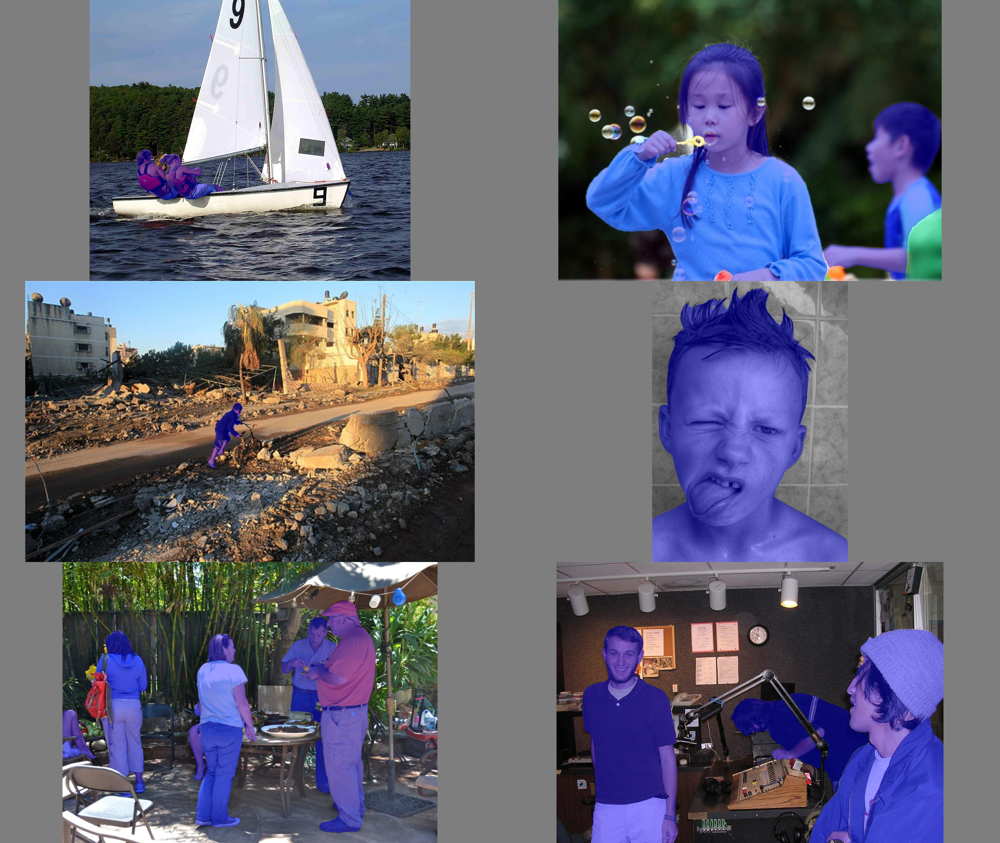

[saved] /home/nico/Projects/final_project/results/notebook04/section04/fig_cohort1_grid.png

[info] cohort2:


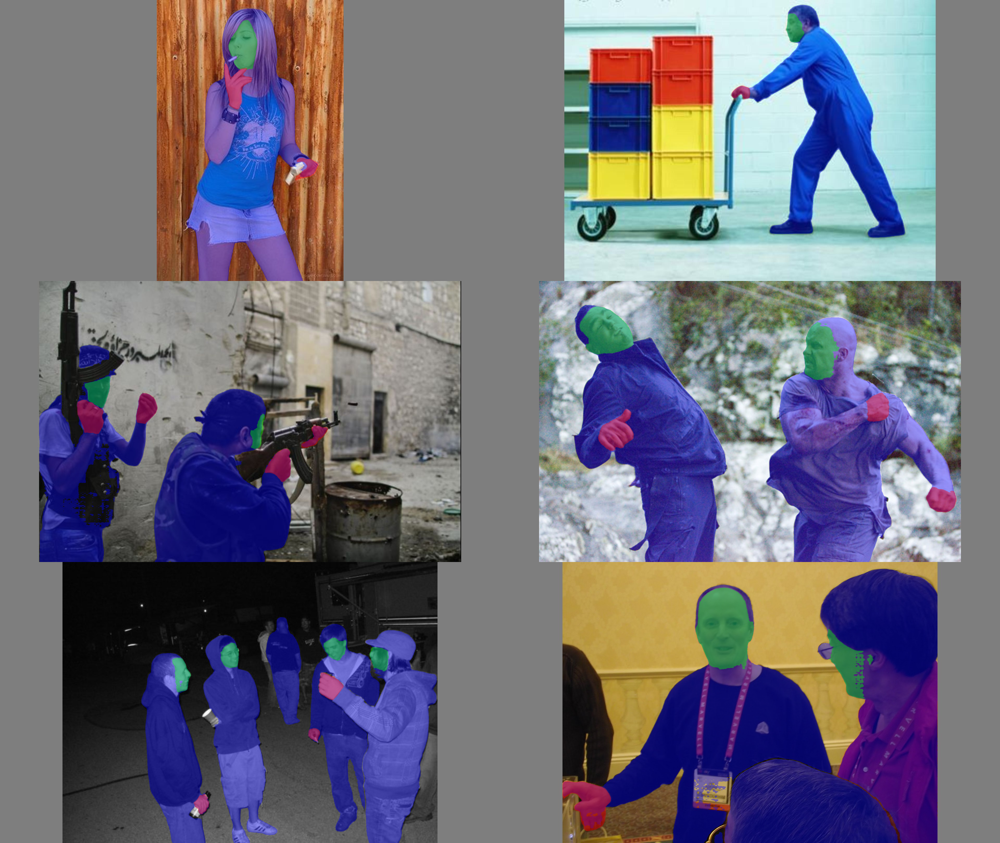

[saved] /home/nico/Projects/final_project/results/notebook04/section04/fig_cohort2_grid.png

[table] cohort1: QC summary (accepted vs. discarded)


,category,n_candidates,n_accepted,n_discarded
0,Action,99,80,19
1,Affective,77,63,14
2,Social,100,38,62
3,Global,276,181,95


[saved] /home/nico/Projects/final_project/results/notebook04/section04/tbl_cohort1_summary.md
[saved] /home/nico/Projects/final_project/results/notebook04/section04/tbl_cohort1_image_list.csv

[table] cohort2: QC summary (accepted vs. discarded)


,category,n_candidates,n_accepted,n_discarded
0,Action,99,12,87
1,Affective,77,10,67
2,Social,100,10,90
3,Global,276,32,244


[saved] /home/nico/Projects/final_project/results/notebook04/section04/tbl_cohort2_summary.md
[saved] /home/nico/Projects/final_project/results/notebook04/section04/tbl_cohort2_image_list.csv


In [8]:
# --- Section 4, Part 2: Curate Overlays and Build Grids ---

def _compose_overlay(image_path, sub_masks, classes, colors, H, W):
    """Compose overlays exactly like your earlier notebooks: JSON masks -> RGBA paste -> alpha_composite."""
    # base image
    base = Image.open(image_path).convert("RGB")
    if base.size != (W, H):
        base = base.resize((W, H), Image.BICUBIC)
    comp = base.convert("RGBA")

    # draw each class in order
    for cls in classes:
        dfc = sub_masks[sub_masks["ai_prompt"] == cls]
        if dfc.empty:
            continue

        col = colors.get(cls, (255, 0, 255))  # default magenta
        # ensure RGBA with mild alpha
        if len(col) == 3:
            col = (col[0], col[1], col[2], 100)
        else:
            col = (int(col[0]), int(col[1]), int(col[2]), int(col[3]))

        for _, row in dfc.iterrows():
            mp = Path(str(row["mask_json_path"]))
            if not mp.is_absolute():
                mp = config.PROJECT_ROOT / mp

            # your masks are saved as JSON arrays of 0/1; load and binarize
            try:
                arr = np.asarray(json.loads(mp.read_text(encoding="utf-8")), dtype=np.uint8)
            except Exception:
                continue
            if arr.ndim != 2:
                continue
            if arr.shape != (H, W):
                arr = np.array(Image.fromarray(arr, mode="L").resize((W, H), Image.NEAREST))

            m = arr > 0
            if not m.any():
                continue

            mask_img = Image.fromarray((m * 255).astype(np.uint8), mode="L")
            overlay = Image.new("RGBA", (W, H))
            overlay.paste(col, (0, 0), mask=mask_img)
            comp = Image.alpha_composite(comp, overlay)

    return comp


def _build_cohort_grid(paths, n_cols, n_rows):
    """Simple grid: uses config.IMG_WIDTH/IMG_HEIGHT for tile size; blanks for missing tiles."""
    tile_w, tile_h = int(config.IMG_WIDTH), int(config.IMG_HEIGHT)
    grid_w, grid_h = n_cols * tile_w, n_rows * tile_h
    grid = Image.new("RGB", (grid_w, grid_h), (255, 255, 255))

    i = 0
    for r in range(n_rows):
        for c in range(n_cols):
            p = paths[i] if i < len(paths) else None
            i += 1
            if p is None or not Path(p).exists():
                tile = Image.new("RGB", (tile_w, tile_h), (245, 245, 245))
            else:
                im = Image.open(p).convert("RGB")
                tile = im.resize((tile_w, tile_h), Image.BICUBIC) if im.size != (tile_w, tile_h) else im
            grid.paste(tile, (c * tile_w, r * tile_h))

    return grid

def enforce_category_order_safe(df: pd.DataFrame, col: str = "category") -> pd.DataFrame:
    """
    Enforce canonical category ordering only for rows whose category is in config.CAT_ORDER.
    Rows with other category values (for example 'Global') are left in place and appended after
    the ordered block. This avoids coercing non-canonical labels to NaN.
    """
    if col not in df.columns:
        return df.copy()

    df = df.copy()
    df[col] = df[col].astype(str)

    canonical_order = list(config.CAT_ORDER)  # expected display names or canonical labels
    mask = df[col].isin(canonical_order)

    ordered_block = df.loc[mask].copy()
    if not ordered_block.empty:
        present_order = [c for c in canonical_order if c in ordered_block[col].unique()]
        dtype = pd.CategoricalDtype(present_order, ordered=True)
        ordered_block[col] = ordered_block[col].astype(dtype)
        ordered_block = ordered_block.sort_values(col)

    remainder = df.loc[~mask].copy()

    return pd.concat([ordered_block.reset_index(drop=True), remainder.reset_index(drop=True)], ignore_index=True)


def curate_and_report_cohorts():
    """
    Reads the edited cohort QC file, regenerates curated overlays,
    and produces final summary grids and tables.
    """

    # --- 1. Load Inputs ---
    cohorts_csv = get_output_path(4, "tbl_qc_image_cohorts.csv")
    masks_csv = get_output_path(2, "log_ai_masks_raw.csv")
    if not cohorts_csv.exists():
        raise FileNotFoundError(f"[error] Missing QC cohort file: {cohorts_csv}")
    if not masks_csv.exists():
        raise FileNotFoundError(f"[error] Missing raw mask log: {masks_csv}")

    df_cohort = pd.read_csv(cohorts_csv)
    df_masks = pd.read_csv(masks_csv)
    
    # Filter masks to only those that passed automated QC
    df_masks_ok = df_masks[df_masks["passed_qc"] == 1].copy()
    masks_by_image = {k: v for k, v in df_masks_ok.groupby("image_id")}

    H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)
    colors = {k: tuple(v) for k, v in config.PROMPT_COLORS.items()}

    cohort_configs = [
        {"name": "cohort1", "flag": "cohort_1", "classes": ["person"]},
        {"name": "cohort2", "flag": "cohort_2", "classes": ["person", "face", "hand"]},
    ]

    grid_paths = {}

    # --- 2. Regenerate Curated Overlays ---
    for cfg in cohort_configs:
        name, flag, classes = cfg["name"], cfg["flag"], cfg["classes"]
        sel = df_cohort[df_cohort[flag] == 1].copy()
        
        out_root = get_output_path(4, "curated_overlays") / name
        grid_paths[name] = []

        if sel.empty:
            print(f"[info] No images accepted for {name}.")
            continue
        
        print(f"[info] Regenerating {name} overlays for {len(sel)} images.")
        for _, r in tqdm(sel.iterrows(), total=len(sel), desc=f"Curating {name}"):
            image_path = config.PROJECT_ROOT / r["image_path"]
            sub_masks = masks_by_image.get(r["image_id"], pd.DataFrame())
            
            # Filter masks for this specific cohort's classes and ensure file path exists
            sub_masks = sub_masks[sub_masks["ai_prompt"].isin(classes)].copy()
            sub_masks = sub_masks[sub_masks["mask_json_path"].astype(str).str.len() > 0]
            
            composed = _compose_overlay(image_path, sub_masks, classes, colors, H, W)
            
            out_path = out_root / r["category"] / f"{image_path.stem}_curated.png"
            out_path.parent.mkdir(parents=True, exist_ok=True)
            composed.convert("RGB").save(out_path)
            grid_paths[name].append(out_path)

    # --- 3. Build and Display Summary Grids ---
    for name, paths in grid_paths.items():
        if not paths: continue
        
        df_paths = pd.DataFrame({"path": paths, "category": [p.parent.name for p in paths]})
        sampled_paths = []
        rng = np.random.RandomState(config.RANDOM_SEED)
        for cat in config.ANTHROPOMORPHIC_CATEGORIES:
            cat_paths = df_paths[df_paths["category"] == cat]["path"].tolist()
            num_to_sample = min(2, len(cat_paths))
            sampled = rng.choice(cat_paths, size=num_to_sample, replace=False).tolist() if cat_paths else []
            sampled += [None] * (2 - len(sampled))
            sampled_paths.extend([Path(p) if p else None for p in sampled])
            
        grid_img = _build_cohort_grid(sampled_paths, n_cols=2, n_rows=len(config.ANTHROPOMORPHIC_CATEGORIES))
        
        grid_png = get_output_path(4, f"fig_{name}_grid.png")
        grid_img.save(grid_png)

        print(f"\n[info] {name}:")
        display(grid_img)
        print(f"[saved] {grid_png}")

    # --- 4. Generate Final Summaries and Cohort Lists ---
    for cfg in cohort_configs:
        name, flag = cfg["name"], cfg["flag"]
        
        candidates = df_cohort
        sel = candidates[candidates[flag] == 1]

        candidates_by_cat = candidates.groupby("category", observed=True).agg(n_candidates=("image_id", "nunique"))
        accepted_by_cat = sel.groupby("category", observed=True).agg(n_accepted=("image_id", "nunique")).reset_index()

        summary_by_cat = pd.merge(candidates_by_cat, accepted_by_cat, on="category", how="left").fillna(0)
        summary_by_cat["n_accepted"] = summary_by_cat["n_accepted"].astype(int)
        summary_by_cat["n_discarded"] = summary_by_cat["n_candidates"] - summary_by_cat["n_accepted"]
        
        summary_global = pd.DataFrame({
            "category": ["Global"], "n_candidates": [candidates['image_id'].nunique()],
            "n_accepted": [sel['image_id'].nunique()], "n_discarded": [candidates['image_id'].nunique() - sel['image_id'].nunique()]
        })
        
        summary_df = pd.concat([summary_global, summary_by_cat.reset_index(drop=True)], ignore_index=True)
        # Use the safe ordering helper so 'Global' is not coerced to NaN
        summary_df = enforce_category_order_safe(summary_df, col="category")
        
        _nice_print_table(summary_df, f"{name}: QC summary (accepted vs. discarded)")
        
        summary_csv = get_output_path(4, f"tbl_{name}_summary.csv")
        summary_md = get_output_path(4, f"tbl_{name}_summary.md")
        summary_df.to_csv(summary_csv, index=False)
        save_dataframe_as_markdown(summary_df, summary_md, title=f"{name.capitalize()} Summary")

        cohort_list_csv = get_output_path(4, f"tbl_{name}_image_list.csv")
        sel[["image_id", "category", "filename", "image_path"]].to_csv(cohort_list_csv, index=False)
        print(f"[saved] {cohort_list_csv}")

# --- Execute Part 2 ---
# This part should only be run after manually editing the tbl_qc_image_cohorts.csv file from Part 1
#curate_and_report_cohorts()

---

### **Section 5: Class Union Construction and Validation**

**Objective**

To construct deterministic, mutually exclusive class-level masks for the accepted images in the two curated cohorts. For Cohort 1, a single `person` union is created. For Cohort 2, unions for `person`, `face`, and `hand` are generated, and a residual `body` mask is derived to support the within-person analysis.

**Rationale**

Raw instance masks from Lang-SAM can overlap (e.g., multiple `person` detections) or be nested (e.g., a `face` inside a `person`). To perform a statistically sound analysis of fixation allocation, each pixel, and thus each fixation, must be assigned to exactly one semantic class. This section enforces this mutual exclusivity. A fixed precedence hierarchy (`Face` over `Hand`, `Hand` over `Body`) is implemented to create a clean partition of the image space, preventing the double-counting of fixations or areas in downstream analyses.

**Methodology**

Accepted images from the QC'd cohort lists (`tbl_cohort1_image_list.csv`, `tbl_cohort2_image_list.csv`) are processed. For each image:

1.  **Union Generation:** All raw instance masks belonging to a given class (`person`, `face`, `hand`) that passed the automated QC are combined via a pixel-wise logicalgunion to form a single mask for that class.
2. **Precedence and exclusivity (Cohort 2 only):** For retained Cohort 2 images, masks are clipped and made mutually exclusive following the precedence.
Precedence follows $\text{Face} \rightarrow \text{Hand} \rightarrow \text{Body}$.

$$
\begin{aligned}
\text{Final\_Face} &= \text{Face} \cap \text{Person}\\
\text{Final\_Hand} &= (\text{Hand} \cap \text{Person}) \setminus \text{Final\_Face}\\
\text{Body} &= \text{Person} \setminus (\text{Final\_Face} \cup \text{Final\_Hand})\\
\text{Outside} &= \text{Image} \setminus \text{Person}
\end{aligned}
$$

3.  **Export:** The final pixel areas for each class are calculated and saved. The final union masks are saved as `.json` files for use in the next notebook.

**Inputs**

*   `results/notebook04/section04/tbl_cohort1_image_list.csv`
*   `results/notebook04/section04/tbl_cohort2_image_list.csv`
*   `results/notebook04/section02/log_ai_masks_raw.csv`

**Outputs**

*   `results/notebook04/section05/class_unions/`: Final, mutually exclusive union masks as `.json` files.
*   `results/notebook04/section05/tbl_class_unions_cohort1.csv`: Area data for Cohort 1.
*   `results/notebook04/section05/tbl_class_unions_cohort2.csv`: Area data for Cohort 2.



In [10]:
# --- Section 5: Class Union Construction and Validation ---

def _load_bool_mask(json_path: Path, expected_hw: tuple[int, int]) -> Optional[np.ndarray]:
    """Load a boolean mask from a JSON file; return None if missing or bad shape."""
    try:
        if not json_path.exists():
            return None
        arr = np.asarray(json.loads(Path(json_path).read_text(encoding="utf-8")), dtype=np.uint8)
        if arr.shape != expected_hw:
            return None
        return arr.astype(bool)
    except Exception:
        return None

def _iter_mask_paths(per_image: pd.DataFrame, cls: str) -> list[Path]:
    """Yield valid JSON mask paths for a class from a per-image mask log frame."""
    sub = per_image[per_image["ai_prompt"] == cls]
    if sub.empty:
        return []
    sub = sub[sub["mask_json_path"].astype(str).str.len() > 0]
    return [config.PROJECT_ROOT / p for p in sub["mask_json_path"].astype(str).tolist()]

def _union_class(per_image: pd.DataFrame, cls: str, H: int, W: int) -> np.ndarray:
    """Boolean union of all accepted instance masks of a class for one image."""
    paths = _iter_mask_paths(per_image, cls)
    if not paths:
        return np.zeros((H, W), dtype=bool)
    out = np.zeros((H, W), dtype=bool)
    for p in paths:
        m = _load_bool_mask(p, (H, W))
        if m is not None:
            out |= m
    return out

def _save_json_mask(mask_bool: np.ndarray, out_path: Path) -> None:
    """Save boolean mask to JSON as ints {0,1}."""
    out_path.parent.mkdir(parents=True, exist_ok=True)
    out_path.write_text(json.dumps(mask_bool.astype(int).tolist(), separators=(",", ":")), encoding="utf-8")

def _warn_if_not_conserved(name: str, areas: dict[int, int], total: int) -> None:
    """Soft check that areas sum to the image size; prints a warning, does not fail."""
    s = sum(int(v) for v in areas.values())
    if s != total:
        print(f"[warn] Area conservation failed in {name}: sum={s}, expected={total}, delta={s - total}")

def build_class_unions():
    """
    Constructs class-level union masks for both cohorts and writes area tables.
    """

    # --- 1. Load Inputs ---
    cohort1_list_csv = get_output_path(4, "tbl_cohort1_image_list.csv")
    cohort2_list_csv = get_output_path(4, "tbl_cohort2_image_list.csv")
    masks_csv        = get_output_path(2, "log_ai_masks_raw.csv")

    if not cohort1_list_csv.exists() or not cohort2_list_csv.exists():
        raise FileNotFoundError("[error] Cohort image list files from Section 4 are missing.")
    if not masks_csv.exists():
        raise FileNotFoundError(f"[error] Missing raw mask log: {masks_csv}")

    df_c1_imgs = pd.read_csv(cohort1_list_csv)
    df_c2_imgs = pd.read_csv(cohort2_list_csv)

    # Only accepted masks, with valid json paths
    df_masks = pd.read_csv(masks_csv)
    df_masks_ok = (
        df_masks[(df_masks["passed_qc"] == 1) & (df_masks["mask_json_path"].astype(str).str.len() > 0)]
        .copy()
    )
    masks_by_image = {k: v for k, v in df_masks_ok.groupby("image_id")}

    H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)
    IMG_PIXELS = H * W

    # --- 2. Cohort 1: Person vs Outside ---
    rows_c1 = []
    out_root_c1 = get_output_path(5, "class_unions") / "cohort1"
    print(f"\n[info] Building Cohort 1 unions for {len(df_c1_imgs)} images.")

    for _, r in tqdm(df_c1_imgs.iterrows(), total=len(df_c1_imgs), desc="Cohort 1 Unions"):
        image_id, category, filename = r["image_id"], r["category"], r["filename"]
        stem = Path(filename).stem
        per_image = masks_by_image.get(image_id, pd.DataFrame())

        P = _union_class(per_image, "person", H, W)
        A_P = int(P.sum())
        A_O = IMG_PIXELS - A_P

        # Save person union
        _save_json_mask(P, out_root_c1 / category / f"{stem}_person.json")

        # Soft conservation check
        _warn_if_not_conserved(f"C1:{image_id}", {"P": A_P, "O": A_O}, IMG_PIXELS)

        rows_c1.append({
            "image_id": image_id, "category": category, "filename": filename,
            "image_width": W, "image_height": H, "A_P": A_P, "A_O": A_O,
        })

    df_c1 = pd.DataFrame(rows_c1).sort_values(["category", "filename"]).reset_index(drop=True)
    for col in ["image_width", "image_height", "A_P", "A_O"]:
        df_c1[col] = df_c1[col].astype(int)
    out_c1_csv = get_output_path(5, "tbl_class_unions_cohort1.csv")
    df_c1.to_csv(out_c1_csv, index=False)
    print(f"[saved] Cohort 1 union areas: {out_c1_csv}")

    # --- 3. Cohort 2: Face, Hand, Body, Outside ---
    rows_c2 = []
    overlap_rows = []  # audit only
    out_root_c2 = get_output_path(5, "class_unions") / "cohort2"
    print(f"\n[info] Building Cohort 2 unions for {len(df_c2_imgs)} images.")

    for _, r in tqdm(df_c2_imgs.iterrows(), total=len(df_c2_imgs), desc="Cohort 2 Unions"):
        image_id, category, filename = r["image_id"], r["category"], r["filename"]
        stem = Path(filename).stem
        per_image = masks_by_image.get(image_id, pd.DataFrame())

        # Raw unions
        P_raw = _union_class(per_image, "person", H, W)
        F_raw = _union_class(per_image, "face",   H, W)
        H_raw = _union_class(per_image, "hand",   H, W)

        # Small audit of raw overlaps (does not affect outputs)
        overlap_rows.append({
            "image_id": image_id, "category": category, "filename": filename,
            "overlap_face_hand": int((F_raw & H_raw).sum()),
            "face_outside_person": int((F_raw & ~P_raw).sum()),
            "hand_outside_person": int((H_raw & ~P_raw).sum()),
        })

        # Precedence and exclusivity
        P   = P_raw
        F   = F_raw & P
        HND = (H_raw & P) & ~F
        B   = P & ~(F | HND)
        O   = ~P

        A_P = int(P.sum());   A_F = int(F.sum());   A_H = int(HND.sum())
        A_B = int(B.sum());   A_O = int(O.sum())

        # Save exclusive masks
        base_dir = out_root_c2 / category
        _save_json_mask(P,   base_dir / f"{stem}_person.json")
        _save_json_mask(F,   base_dir / f"{stem}_face.json")
        _save_json_mask(HND, base_dir / f"{stem}_hand.json")
        _save_json_mask(B,   base_dir / f"{stem}_body.json")

        # Soft conservation + orthogonality checks
        _warn_if_not_conserved(f"C2:{image_id}", {"F": A_F, "H": A_H, "B": A_B, "O": A_O}, IMG_PIXELS)
        if (F & HND).any():
            print(f"[warn] Non-exclusive F∩HND > 0 in {image_id}")
        if (F & ~P).any() or (HND & ~P).any() or (B & ~P).any():
            print(f"[warn] Class outside person in {image_id}")

        rows_c2.append({
            "image_id": image_id, "category": category, "filename": filename,
            "image_width": W, "image_height": H,
            "A_P": A_P, "A_F": A_F, "A_H": A_H, "A_B": A_B, "A_O": A_O,
        })

    df_c2 = pd.DataFrame(rows_c2).sort_values(["category", "filename"]).reset_index(drop=True)
    for col in ["image_width", "image_height", "A_P", "A_F", "A_H", "A_B", "A_O"]:
        df_c2[col] = df_c2[col].astype(int)

    out_c2_csv = get_output_path(5, "tbl_class_unions_cohort2.csv")
    df_c2.to_csv(out_c2_csv, index=False)
    print(f"[saved] Cohort 2 union areas: {out_c2_csv}")

    # Overlap audit (appendix-only, harmless to main flow)
    df_overlap = pd.DataFrame(overlap_rows).sort_values(["category", "filename"]).reset_index(drop=True)
    out_overlap_csv = get_output_path(5, "tbl_union_overlap_audit.csv")
    df_overlap.to_csv(out_overlap_csv, index=False)
    print(f"[saved] Overlap audit (appendix): {out_overlap_csv}")

# --- Execute Analysis ---
build_class_unions()


[info] Building Cohort 1 unions for 181 images.


Cohort 1 Unions: 100%|██████████| 181/181 [01:45<00:00,  1.72it/s]


[saved] Cohort 1 union areas: /home/nico/Projects/final_project/results/notebook04/section05/tbl_class_unions_cohort1.csv

[info] Building Cohort 2 unions for 32 images.


Cohort 2 Unions: 100%|██████████| 32/32 [00:56<00:00,  1.77s/it]

[saved] Cohort 2 union areas: /home/nico/Projects/final_project/results/notebook04/section05/tbl_class_unions_cohort2.csv
[saved] Overlap audit (appendix): /home/nico/Projects/final_project/results/notebook04/section05/tbl_union_overlap_audit.csv


---

### **Section 6: Fixation Assignment and Validation**

**Objective**

To assign every raw fixation point from the CAT2000 dataset to a single, mutually exclusive semantic class based on the validated unions constructed in Section 5. This step bridges the raw gaze data with the derived semantic segmentations, producing the final data tables required for the analyses in Notebook 05.

**Rationale**

To perform a statistically sound analysis of attentional allocation, each fixation must be unambiguously attributed to one semantic category. The precedence-based assignment protocol ensures that every fixation is counted exactly once, preventing analytical errors that would arise from double-counting or ambiguous assignments. Importantly, the assignment process weights each pixel by its total fixation count, ensuring that the analysis reflects the true distribution of gaze time, not just the spatial extent of fixated locations. The process is fully deterministic and auditable.

**Methodology**

The procedure iterates through each image in the curated cohorts. For each image, it loads the raw fixation coordinates from the corresponding `.mat` file, automatically converting from 1-based to 0-based indexing if detected. The data is rasterized into a 2D fixation-count map. The total number of fixations within the image bounds (`n_in`) is calculated directly from this map. Each valid fixation contributes its multiplicity to the count for the highest-priority semantic class it falls within, following the strict precedence Face -> Hand -> Body -> Outside. A conservation check validates that the sum of assigned counts equals `n_in` for every image.

**Inputs**

*   `results/notebook04/section04/tbl_cohort1_image_list.csv` and `tbl_cohort2_image_list.csv`
*   `results/notebook04/section05/class_unions/`: The final union masks.
*   CAT2000 `.mat` files.

**Outputs**

*   `results/notebook04/section06/tbl_fixation_assignment_cohort1.csv`: Per-image counts, ground-truth totals, and areas for Cohort 1.
*   `results/notebook04/section06/tbl_fixation_assignment_cohort2.csv`: Per-image counts, ground-truth totals, and areas for Cohort 2.
*   `results/notebook04/section06/log_fixation_assignment_bounds_issues.csv`: An optional log of out-of-bounds fixations.
*   `results/notebook04/section06/log_fixation_assignment_conservation_failures.csv`: An optional log of images where assigned counts do not sum to the total.


In [13]:
# --- Section 6: Fixation Assignment and Validation ---

def _load_fixation_mat_robust(mat_path: Path) -> Tuple[np.ndarray, int, int]:
    """
    Robustly loads a CAT2000 fixation file, handling 1-based indexing.
    Returns (fixation_map, total_fixations, out_of_bounds_count).

    Behavior:
    - Fails loudly on missing files or unknown formats.
    - Accepts both fixation maps and coordinate lists.
    - For coordinate lists, uses ROUND-THEN-CLIP indexing policy.
    - Counts 'out_of_bounds' as coordinates that fall outside the image
      after (optional) 1-based adjustment and rounding, before clipping.
    """
    H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)

    if not mat_path.exists():
        raise FileNotFoundError(f"Missing fixation file: {mat_path}")

    m = scipy.io.loadmat(mat_path)
    # Accept common CAT2000 variants (map or coordinates)
    accepted_keys = ("fixLocs", "gnd", "fixLocsXY", "fixLocs_XY", "fixations", "map")
    arr = next((np.asarray(m[k]) for k in accepted_keys if k in m), None)
    if arr is None or arr.size == 0:
        raise ValueError(f"Unknown or empty fixation format in {mat_path.name}")

    # Case A: precomputed fixation map
    if arr.ndim == 2 and arr.shape == (H, W):
        fm = np.asarray(arr, dtype=np.float64)
        fm = np.rint(fm)                # elementwise rounding to nearest
        fm = np.clip(fm, a_min=0, a_max=None)
        fm_i32 = fm.astype(np.int32)
        total_fix = int(fm_i32.sum())
        return fm_i32, total_fix, 0

    # Case B: list of coordinates (N×2 or 2×N)
    if arr.ndim == 2:
        coords = arr if arr.shape[1] == 2 else arr.T
        if coords.shape[1] != 2:
            raise ValueError(f"Fixation coordinate array must be Nx2 or 2xN in {mat_path.name}")

        x_raw = coords[:, 0].astype(float)
        y_raw = coords[:, 1].astype(float)
        total_fix = int(coords.shape[0])

        # Heuristic: 1-based indexing if within [1..W] × [1..H]
        one_based = (x_raw.min() >= 1) and (y_raw.min() >= 1) and (x_raw.max() <= W) and (y_raw.max() <= H)
        if one_based:
            x_raw = x_raw - 1.0
            y_raw = y_raw - 1.0

        # ROUND first, then compute OOB, then CLIP
        x_rounded = np.rint(x_raw)
        y_rounded = np.rint(y_raw)

        oob_mask = (x_rounded < 0) | (x_rounded >= W) | (y_rounded < 0) | (y_rounded >= H)
        oob_count = int(oob_mask.sum())

        xs = np.clip(x_rounded, 0, W - 1).astype(np.int32)
        ys = np.clip(y_rounded, 0, H - 1).astype(np.int32)

        fixmap = np.zeros((H, W), dtype=np.int32)
        np.add.at(fixmap, (ys, xs), 1)
        return fixmap, total_fix, oob_count

    raise ValueError(f"Unhandled fixation array shape {arr.shape} in {mat_path.name}")


def _load_bool_mask(json_path: Path, expected_hw: Tuple[int, int]) -> Optional[np.ndarray]:
    """
    Loads a boolean mask from a JSON file that stores a 2D 0/1 array.
    Returns None if file missing or shape mismatch.
    """
    if not json_path.exists():
        return None
    with open(json_path, "r", encoding="utf-8") as f:
        arr = np.asarray(json.load(f), dtype=np.uint8)
    if arr.shape != expected_hw:
        return None
    return arr.astype(bool)


def assign_fixations_to_unions():
    """
    Assigns all fixations to class unions for both cohorts using weighted,
    pixel-wise precedence logic. Every fixation contributes its full count.

    Validations:
    - Logs out-of-bounds fixation counts (pre-clipping).
    - Asserts conservation by counts:
        Cohort 1: n_P + n_O == n_in
        Cohort 2: n_F + n_H + n_B + n_O == n_in
    - Logs an area-based within-person identity for Cohort 2 masks:
        A_F + A_H + A_B == A_P (where A_P = area of (F ∪ H ∪ B))
    """

    # --- 1. Load Inputs ---
    cohort1_list_path = get_output_path(4, "tbl_cohort1_image_list.csv")
    cohort2_list_path = get_output_path(4, "tbl_cohort2_image_list.csv")
    unions_c1_path = get_output_path(5, "tbl_class_unions_cohort1.csv")
    unions_c2_path = get_output_path(5, "tbl_class_unions_cohort2.csv")

    df_cohort1 = pd.read_csv(cohort1_list_path)
    df_cohort2 = pd.read_csv(cohort2_list_path)
    df_unions_c1 = pd.read_csv(unions_c1_path)
    df_unions_c2 = pd.read_csv(unions_c2_path)

    unions_root = get_output_path(5, "class_unions")
    H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)

    oob_log = []
    conservation_failures = []
    area_identity_log = []  # for cohort 2: A_F + A_H + A_B vs A_P

    # --- 2. Process Cohort 1 ---
    rows_c1 = []
    print(f"\n[info] Assigning fixations for Cohort 1 ({len(df_cohort1)} images)")
    for _, r in tqdm(df_cohort1.iterrows(), total=len(df_cohort1), desc="Assigning Cohort 1"):
        stem = Path(r["filename"]).stem
        mat_path = config.FIXATIONLOCS_DIR / r["category"] / f"{stem}.mat"

        fix_map, n_gt, n_oob = _load_fixation_mat_robust(mat_path)
        if n_oob > 0:
            oob_log.append({"image_id": r["image_id"], "n_oob": n_oob})

        if fix_map.shape != (H, W):
            raise ValueError(f"Fixation map shape {fix_map.shape} != expected {(H, W)} for {r['image_id']}")

        fix_map = fix_map.astype(np.int64, copy=False)
        n_in = int(fix_map.sum())

        mask_p_path = unions_root / "cohort1" / r["category"] / f"{stem}_person.json"
        mask_p = _load_bool_mask(mask_p_path, (H, W))
        if mask_p is None:
            raise FileNotFoundError(f"Missing or bad person mask for {r['image_id']}")

        n_p = int((fix_map * mask_p).sum())
        n_o = n_in - n_p

        if (n_p + n_o) != n_in:
            conservation_failures.append({"image_id": r["image_id"], "cohort": 1})

        rows_c1.append(
            {
                "image_id": r["image_id"],
                "n_P": n_p,
                "n_O": n_o,
                "n_gt_total": int(n_gt),
            }
        )

    df_assign_c1 = pd.DataFrame(rows_c1)
    df_final_c1 = pd.merge(df_unions_c1, df_assign_c1, on="image_id", how="inner")
    out_c1_csv = get_output_path(6, "tbl_fixation_assignment_cohort1.csv")
    df_final_c1.to_csv(out_c1_csv, index=False)
    print(f"[saved] {out_c1_csv}")

    # --- 3. Process Cohort 2 ---
    rows_c2 = []
    print(f"\n[info] Assigning fixations for Cohort 2 ({len(df_cohort2)} images)")
    for _, r in tqdm(df_cohort2.iterrows(), total=len(df_cohort2), desc="Assigning Cohort 2"):
        stem = Path(r["filename"]).stem
        mat_path = config.FIXATIONLOCS_DIR / r["category"] / f"{stem}.mat"

        fix_map, n_gt, n_oob = _load_fixation_mat_robust(mat_path)
        if n_oob > 0:
            oob_log.append({"image_id": r["image_id"], "n_oob": n_oob})

        if fix_map.shape != (H, W):
            raise ValueError(f"Fixation map shape {fix_map.shape} != expected {(H, W)} for {r['image_id']}")

        fix_map = fix_map.astype(np.int64, copy=False)
        n_in = int(fix_map.sum())

        base = unions_root / "cohort2" / r["category"]
        mask_f = _load_bool_mask(base / f"{stem}_face.json", (H, W))
        mask_h = _load_bool_mask(base / f"{stem}_hand.json", (H, W))
        mask_b = _load_bool_mask(base / f"{stem}_body.json", (H, W))
        if any(m is None for m in (mask_f, mask_h, mask_b)):
            raise FileNotFoundError(f"Missing one or more C2 masks for {r['image_id']}")

        # Fixation assignment by exclusive masks
        n_f = int((fix_map * mask_f).sum())
        n_h = int((fix_map * mask_h).sum())
        n_b = int((fix_map * mask_b).sum())
        n_o = n_in - (n_f + n_h + n_b)

        if (n_f + n_h + n_b + n_o) != n_in:
            conservation_failures.append({"image_id": r["image_id"], "cohort": 2})

        # Area identity within person (diagnostic)
        A_f = int(mask_f.sum())
        A_h = int(mask_h.sum())
        A_b = int(mask_b.sum())
        mask_p_union = mask_f | mask_h | mask_b
        A_p = int(mask_p_union.sum())
        area_delta = (A_f + A_h + A_b) - A_p  # should be 0 for exclusive masks
        area_identity_log.append(
            {"image_id": r["image_id"], "A_F": A_f, "A_H": A_h, "A_B": A_b, "A_P": A_p, "delta_FHB_minus_P": area_delta}
        )

        rows_c2.append(
            {
                "image_id": r["image_id"],
                "n_F": n_f,
                "n_H": n_h,
                "n_B": n_b,
                "n_O": n_o,
                "n_gt_total": int(n_gt),
            }
        )

    df_assign_c2 = pd.DataFrame(rows_c2)
    df_final_c2 = pd.merge(df_unions_c2, df_assign_c2, on="image_id", how="inner")
    out_c2_csv = get_output_path(6, "tbl_fixation_assignment_cohort2.csv")
    df_final_c2.to_csv(out_c2_csv, index=False)
    print(f"[saved] {out_c2_csv}")

    # --- 4. Optional logs ---
    if oob_log:
        df_oob = pd.DataFrame(oob_log).drop_duplicates().sort_values("image_id")
        oob_csv = get_output_path(6, "log_fixation_assignment_bounds_issues.csv")
        df_oob.to_csv(oob_csv, index=False)
        print(f"[info] {len(df_oob)} images had out-of-bounds fixations. Log saved to: {oob_csv}")

    if conservation_failures:
        df_cons = pd.DataFrame(conservation_failures).drop_duplicates()
        cons_csv = get_output_path(6, "log_fixation_assignment_conservation_failures.csv")
        df_cons.to_csv(cons_csv, index=False)
        print(f"[warn] {len(df_cons)} images failed the conservation check. Log saved to: {cons_csv}")

    if area_identity_log:
        df_area = pd.DataFrame(area_identity_log)
        area_csv = get_output_path(6, "log_within_person_area_identity.csv")
        df_area.to_csv(area_csv, index=False)
        # Optional hard assertion for curated cohorts:
        if (df_area["delta_FHB_minus_P"] != 0).any():
             raise ValueError("Within-person area identity violated for some images. See log.")

# --- Execute Section 6 ---
assign_fixations_to_unions()


[info] Assigning fixations for Cohort 1 (181 images)


Assigning Cohort 1: 100%|██████████| 181/181 [00:26<00:00,  6.87it/s]


[saved] /home/nico/Projects/final_project/results/notebook04/section06/tbl_fixation_assignment_cohort1.csv

[info] Assigning fixations for Cohort 2 (32 images)


Assigning Cohort 2: 100%|██████████| 32/32 [00:12<00:00,  2.66it/s]

[saved] /home/nico/Projects/final_project/results/notebook04/section06/tbl_fixation_assignment_cohort2.csv


---

### **Section 7: Post-Assignment Validation and Visual Audit**

**Objective**

To verify the integrity of the fixation assignment process, generate compact diagnostic summaries, and produce auditable visual overlays. This final validation ensures the data is sound before its use in hypothesis testing.

**Rationale**

Before hypothesis testing, a final set of checks confirms data integrity. A conservation check validates that no fixations were lost during assignment. Diagnostic summaries, like the noise rate and the relationship between class area and fixation share, provide a high-level validation that the results are plausible and ready for formal analysis in Notebook 05. Finally, a deterministic visual audit provides qualitative proof that the entire pipeline (from segmentation to assignment) is functioning as intended.

**Methodology**

The analysis loads the final assignment tables from Section 6.

1.  **Conservation validation:** The sum of assigned fixations per image is compared against the ground-truth total of in-bounds fixations, which is re-calculated from the raw `.mat` file for robustness. Any image failing this check is logged.
2.  **Noise rate calculation:** The noise rate (proportion of in-bounds fixations landing `Outside` all defined semantic regions) is computed for each image.
3.  **Area vs. fixation share analysis:** The proportion of image area covered by each class is compared to the proportion of fixations it received.
4.  **Visual audit:** Three images are generated for the high-confidence Cohort 2. Each sample includes two panels: (i) the stimulus with final class masks overlaid, and (ii) the stimulus with raw fixation points colored by their assigned semantic class. 

**Inputs**

*   `results/notebook04/section06/tbl_fixation_assignment_cohort1.csv` and `tbl_fixation_assignment_cohort2.csv`

**Outputs**

*   `results/notebook04/section07/tbl_area_vs_fixation_cohort1.csv`: Summary table for Cohort 1.
*   `results/notebook04/section07/tbl_area_vs_fixation_cohort2.csv`: Summary table for Cohort 2.
*   `results/notebook04/section07/fig_visual_audit_grid.png`: The final combined diagnostic figure.
*   `results/notebook04/section07/visual_audit/`: A directory with individual audit panels for each image.


[info] Conservation check passed for all images.

[table] Cohort 1 Summary


,n_in,noise_rate,area_pct_P,fix_share_P
category,,,,
Action,342.812,0.607,0.096,0.393
Affective,357.587,0.306,0.255,0.694
Social,370.526,0.402,0.298,0.598


[saved] /home/nico/Projects/final_project/results/notebook04/section07/tbl_area_vs_fixation_cohort1.md

[table] Cohort 2 Summary


,area_pct_F,fix_share_F,area_pct_H,fix_share_H,area_pct_B,fix_share_B,noise_rate
category,,,,,,,
Action,0.016,0.173,0.009,0.030,0.201,0.354,0.443
Affective,0.024,0.219,0.023,0.089,0.173,0.337,0.355
Social,0.035,0.311,0.016,0.019,0.381,0.420,0.250


[saved] /home/nico/Projects/final_project/results/notebook04/section07/tbl_area_vs_fixation_cohort2.md


Generating Audits: 100%|██████████| 32/32 [00:41<00:00,  1.29s/it]


[saved] /home/nico/Projects/final_project/results/notebook04/section07/visual_audit
[saved] /home/nico/Projects/final_project/results/notebook04/section07/fig_visual_audit_grid.png

[info] Sample of Visual Audit:


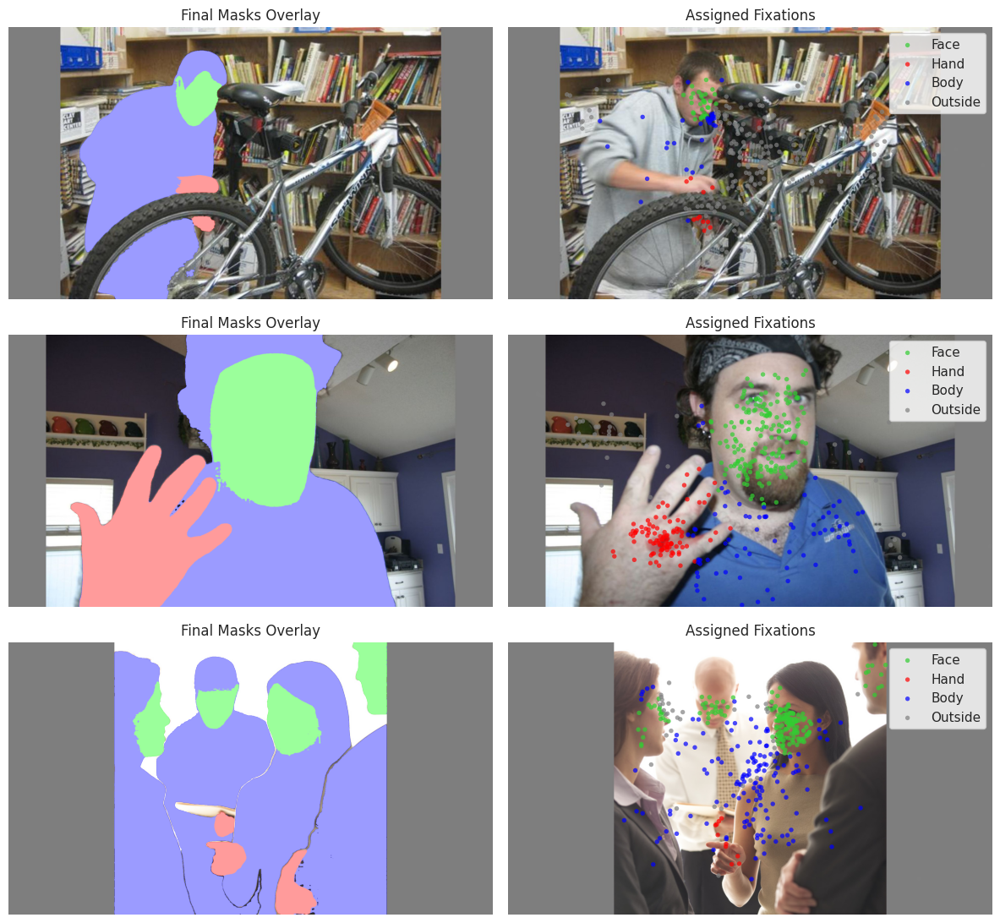

In [20]:
# --- Section 7: Post-Assignment Validation and Visual Audit ---

# Optional: set to True if you want scatter size to reflect fixation multiplicity
SCALE_POINTS_BY_COUNT = False

def _load_fixation_mat_robust(mat_path: Path) -> Tuple[np.ndarray, int, int]:
    """
    Robustly loads a CAT2000 fixation file, handling 1-based indexing.
    Returns: (fixation_map, total_fixations_in_file, out_of_bounds_count_before_clipping)
    """
    H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)
    try:
        if not mat_path.exists():
            return np.zeros((H, W), dtype=np.int32), 0, 0

        m = scipy.io.loadmat(mat_path)
        arr = next((np.asarray(m[k]) for k in ("fixLocs", "gnd", "fixLocsXY", "fixations", "map") if k in m), None)
        if arr is None or arr.size == 0:
            return np.zeros((H, W), dtype=np.int32), 0, 0

        # Case A: fixation map provided
        if arr.ndim == 2 and arr.shape == (H, W):
            fm = np.asarray(arr, dtype=np.float64)
            fm = np.rint(fm).clip(min=0)         
            fm_i32 = fm.astype(np.int32)
            total_fix = int(fm_i32.sum())
            return fm_i32, total_fix, 0

        # Case B: coordinate list
        if arr.ndim == 2:
            coords = arr if arr.shape[1] == 2 else arr.T
            if coords.shape[1] != 2:
                return np.zeros((H, W), dtype=np.int32), 0, 0

            x_raw = coords[:, 0].astype(float)
            y_raw = coords[:, 1].astype(float)
            total_fix = int(coords.shape[0])

            one_based = (x_raw.min() >= 1 and y_raw.min() >= 1 and
                         x_raw.max() <= W and y_raw.max() <= H)
            if one_based:
                x_raw -= 1.0
                y_raw -= 1.0

            oob_mask = (x_raw < 0) | (x_raw >= W) | (y_raw < 0) | (y_raw >= H)
            oob_count = int(oob_mask.sum())

            xs = np.clip(np.rint(x_raw), 0, W - 1).astype(np.int32)
            ys = np.clip(np.rint(y_raw), 0, H - 1).astype(np.int32)

            fixmap = np.zeros((H, W), dtype=np.int32)
            np.add.at(fixmap, (ys, xs), 1)
            return fixmap, total_fix, oob_count

    except Exception:
        return np.zeros((H, W), dtype=np.int32), 0, 0

    return np.zeros((H, W), dtype=np.int32), 0, 0


def _load_bool_mask(json_path: Path, expected_hw: Tuple[int, int]) -> Optional[np.ndarray]:
    if not json_path.exists():
        return None
    try:
        with open(json_path, "r", encoding="utf-8") as f:
            arr = np.asarray(json.load(f), dtype=np.uint8)
        if arr.shape != expected_hw:
            return None
        return arr.astype(bool)
    except Exception:
        return None


def perform_post_assignment_checks_and_audit():
    """
    Runs conservation checks, generates summary tables, and creates a visual
    audit grid for the final fixation assignments.
    """

    H, W = int(config.IMG_HEIGHT), int(config.IMG_WIDTH)
    unions_root = get_output_path(5, "class_unions")

    def _create_single_audit_figure(image_path, assigned_classes, mask_files, H, W):
        stim_img = Image.open(image_path).convert("RGB")
        fig, axes = plt.subplots(1, 2, figsize=(12, 6), dpi=100)
        ax1, ax2 = axes

        overlay_img = stim_img.copy().convert("RGBA")
        mask_colors = {"Face": (0, 255, 0, 100), "Hand": (255, 0, 0, 100), "Body": (0, 0, 255, 100)}
        for cls, color in mask_colors.items():
            m_path = mask_files.get(cls)
            if m_path and Path(m_path).exists():
                mask_bool = _load_bool_mask(Path(m_path), (H, W))
                if mask_bool is not None and mask_bool.any():
                    color_img = Image.new("RGBA", (W, H), color)
                    mask_pil = Image.fromarray((mask_bool * 255).astype(np.uint8), mode="L")
                    overlay_img.paste(color_img, (0, 0), mask=mask_pil)
        ax1.imshow(overlay_img); ax1.set_title("Final Masks Overlay"); ax1.axis("off")

        ax2.imshow(stim_img)
        fixation_colors = {"Face": "#32CD32", "Hand": "#FF0000", "Body": "#0000FF", "Outside": "#808080"}
        for cls, points in assigned_classes.items():
            if len(points) > 0:
                pts = np.array(points)
                if SCALE_POINTS_BY_COUNT and pts.shape[1] == 3:
                    # pts columns: x, y, count
                    ax2.scatter(pts[:, 0], pts[:, 1], s=4 + 2*pts[:, 2], color=fixation_colors[cls],
                                alpha=0.7, edgecolors='none', label=cls)
                else:
                    ax2.scatter(pts[:, 0], pts[:, 1], s=15, color=fixation_colors[cls],
                                alpha=0.7, edgecolors='none', label=cls)
        ax2.set_title("Assigned Fixations")
        if any(len(p) > 0 for p in assigned_classes.values()):
            ax2.legend(loc="upper right", frameon=True)
        ax2.axis("off")

        plt.tight_layout()
        buf = io.BytesIO()
        fig.savefig(buf, format="png", bbox_inches="tight", pad_inches=0.1)
        buf.seek(0)
        audit_image = Image.open(buf)
        plt.close(fig)
        return audit_image

    # --- 1. Load Inputs ---
    df_c1 = pd.read_csv(get_output_path(6, "tbl_fixation_assignment_cohort1.csv"))
    df_c2 = pd.read_csv(get_output_path(6, "tbl_fixation_assignment_cohort2.csv"))

    # --- 2. Recompute in-bounds totals (n_in) for conservation and shares ---
    def _inbounds_total(row):
        mat_path = config.FIXATIONLOCS_DIR / row["category"] / f"{Path(row['filename']).stem}.mat"
        fix_map, _, _ = _load_fixation_mat_robust(mat_path)
        return int(np.asarray(fix_map, dtype=np.int64).sum())

    if not df_c1.empty: df_c1["n_in"] = df_c1.apply(_inbounds_total, axis=1)
    if not df_c2.empty: df_c2["n_in"] = df_c2.apply(_inbounds_total, axis=1)

    # --- 3. Conservation Checks ---
    cons_fails_c1 = df_c1[df_c1[["n_P", "n_O"]].sum(axis=1) != df_c1["n_in"]] if not df_c1.empty else pd.DataFrame()
    cons_fails_c2 = df_c2[df_c2[["n_F", "n_H", "n_B", "n_O"]].sum(axis=1) != df_c2["n_in"]] if not df_c2.empty else pd.DataFrame()
    if not cons_fails_c1.empty or not cons_fails_c2.empty:
        print(f"[warn] Conservation check failed for {len(cons_fails_c1) + len(cons_fails_c2)} images.")
    else: print("[info] Conservation check passed for all images.")

    # --- 4. Noise Rate and Area vs. Fixation Share Analysis ---
    if not df_c1.empty:
        df_c1['noise_rate'] = df_c1['n_O'] / df_c1['n_in'].replace(0, np.nan)
        df_c1['area_pct_P'] = df_c1['A_P'] / (df_c1['A_P'] + df_c1['A_O']).replace(0, np.nan)
        df_c1['fix_share_P'] = df_c1['n_P'] / df_c1['n_in'].replace(0, np.nan)
        c1_tbl = df_c1[["category", "filename", "n_in", "noise_rate", "area_pct_P", "fix_share_P"]].copy()
        c1_summary = c1_tbl.groupby('category', observed=True).mean(numeric_only=True).round(3)
        _nice_print_table(c1_summary, "Cohort 1 Summary")
        md_path = get_output_path(7, "tbl_area_vs_fixation_cohort1.md")
        csv_path = get_output_path(7, "tbl_area_vs_fixation_cohort1.csv")
        save_dataframe_as_markdown(c1_tbl.round(3), md_path, title="Cohort 1: Area vs Fixation Share")
        c1_tbl.round(3).to_csv(csv_path, index=False)

    if not df_c2.empty:
        df_c2['noise_rate'] = df_c2['n_O'] / df_c2['n_in'].replace(0, np.nan)
        total_area_c2 = (df_c2['A_F'] + df_c2['A_H'] + df_c2['A_B'] + df_c2['A_O']).replace(0, np.nan)
        for cls in ['F', 'H', 'B', 'O']:
            df_c2[f'area_pct_{cls}'] = df_c2[f'A_{cls}'] / total_area_c2
            df_c2[f'fix_share_{cls}'] = df_c2[f'n_{cls}'] / df_c2['n_in'].replace(0, np.nan)
        c2_summary = df_c2.groupby('category', observed=True).mean(numeric_only=True)[
            ["area_pct_F", "fix_share_F", "area_pct_H", "fix_share_H", "area_pct_B", "fix_share_B", "noise_rate"]
        ].round(3)
        _nice_print_table(c2_summary, "Cohort 2 Summary")
        md_path = get_output_path(7, "tbl_area_vs_fixation_cohort2.md")
        csv_path = get_output_path(7, "tbl_area_vs_fixation_cohort2.csv")
        save_dataframe_as_markdown(c2_summary.reset_index().round(3), md_path,
                                   title="Cohort 2: Area vs Fixation Share Summary")
        c2_summary.reset_index().round(3).to_csv(csv_path, index=False)
        
    # --- 5. Visual Audit of Cohort 2 ---
    audit_dir = get_output_path(7, "visual_audit")
    audit_dir.mkdir(parents=True, exist_ok=True)
    all_audit_paths = []

    if not df_c2.empty:
        for _, r in tqdm(df_c2.iterrows(), total=len(df_c2), desc="Generating Audits"):
            image_path = config.STIMULI_DIR / r["category"] / r["filename"]
            mat_path = config.FIXATIONLOCS_DIR / r["category"] / f"{Path(r['filename']).stem}.mat"
            fix_map, _, _ = _load_fixation_mat_robust(mat_path)
            fix_y, fix_x = np.nonzero(fix_map)
            counts = fix_map[fix_y, fix_x]

            stem = Path(r["filename"]).stem
            mask_files = {
                "Face": unions_root / "cohort2" / r["category"] / f"{stem}_face.json",
                "Hand": unions_root / "cohort2" / r["category"] / f"{stem}_hand.json",
                "Body": unions_root / "cohort2" / r["category"] / f"{stem}_body.json",
            }

            mask_f = _load_bool_mask(mask_files["Face"], (H,W))
            mask_h = _load_bool_mask(mask_files["Hand"], (H,W))
            mask_b = _load_bool_mask(mask_files["Body"], (H,W))

            if any(m is None for m in (mask_f, mask_h, mask_b)): continue

            is_in_f = mask_f[fix_y, fix_x]
            is_in_h = mask_h[fix_y, fix_x] & ~is_in_f
            is_in_b = mask_b[fix_y, fix_x] & ~is_in_f & ~is_in_h
            is_out  = ~(is_in_f | is_in_h | is_in_b)

            def _pack(ix):
                return list(zip(fix_x[ix], fix_y[ix], counts[ix])) if SCALE_POINTS_BY_COUNT else list(zip(fix_x[ix], fix_y[ix]))

            assigned_classes = {
                "Face": _pack(is_in_f), "Hand": _pack(is_in_h),
                "Body": _pack(is_in_b), "Outside": _pack(is_out),
            }

            audit_fig = _create_single_audit_figure(image_path, assigned_classes, mask_files, H, W)
            audit_path = audit_dir / f"{r['category']}_{stem}_audit.png"
            audit_fig.save(audit_path)
            all_audit_paths.append(audit_path)

        print(f"[saved] {audit_dir}")
        
        # Deterministic sample grid
        if all_audit_paths:
            sample_paths = []
            rng = np.random.RandomState(config.RANDOM_SEED)
            for cat in config.ANTHROPOMORPHIC_CATEGORIES:
                cat_paths = [p for p in all_audit_paths if Path(p).name.startswith(f"{cat}_")]
                if cat_paths:
                    sample_paths.append(rng.choice(cat_paths))

            if sample_paths:
                tiles = [Image.open(p).convert("RGB") for p in sample_paths]
                tile_w, tile_h = tiles[0].size
                grid = Image.new("RGB", (tile_w, tile_h * len(tiles)))
                for i, im in enumerate(tiles): grid.paste(im, (0, i * tile_h))
                
                grid_png = get_output_path(7, "fig_visual_audit_grid.png")
                grid.save(grid_png)
                print(f"[saved] {grid_png}")
                print("\n[info] Sample of Visual Audit:")
                display(grid)

# --- Execute Analysis ---
perform_post_assignment_checks_and_audit()

**Results**

Cohort 1: Of 276 candidate images, 181 (65%) passed QC. On average, noise rates were moderate (0.31-0.61 across categories). Fixation shares on persons were consistently larger than their proportional area coverage, showing clear preferential allocation of gaze.

Cohort 2: Much stricter criteria reduced the dataset to only 32 images (12%). Within these, fixation shares on faces and hands were far higher than their area percentages (e.g., faces: ~2-4% area but ~17-31% fixations). Body regions were closer to proportionality, and noise rates were lower than Cohort 1 for most categories.

Audits: Visual overlays confirmed that fixations were cleanly assigned to exclusive classes (Face -> Hand -> Body -> Outside).

**Interpretation**

The QC bottleneck is clear: segmentation issues mean only ~1/3 of Cohort 1 and ~1/10 of Cohort 2 are suitable for analysis. However, the retained images show meaningful trends: gaze is concentrated disproportionately on semantically salient regions (faces and hands), validating the segmentation-based allocation strategy.

Cohort 1 captures a broad person-vs-outside distinction, but its higher noise reflects less precise boundaries. Cohort 2, though smaller, provides high-quality evidence of fine-grained attentional allocation patterns.

**Conclusion**

Notebook 04 successfully transformed raw segmentations into high-confidence semantic masks and validated fixation assignments. Despite substantial attrition during QC, the final curated datasets are reliable and exhibit interpretable gaze–area dissociations that motivate the statistical tests in Notebook 05. The outputs are consistent, conservation checks passed, and the visual audits provide strong face validity.